In [36]:
import numpy as np
import pandas as pd 
from pathlib import Path
from pulp import *
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import time 
import scipy.stats as stats
from PIL import Image
import random

In [37]:
project_name = 'multicategory'
PATH_TO_PROJECT = Path.cwd().parent.parent.parent / 'projects' / project_name
PATH_TO_RAW_DATA = PATH_TO_PROJECT / 'raw data' 
PATH_TO_EXPERIMENT_CSV_FILES = PATH_TO_PROJECT / 'experiment 1' / 'experiment resources' / 'csvs'

### plot mean similarity per category

In [40]:
all_cat_sim_df = pd.DataFrame([])

for cat in ['badlands','bridge','highway','golf_course','playground','mountain']:
    name = cat + '_epsilon_0.05.csv'
    if cat in ('highway','golf_course') :
        name = cat + '_epsilon_0.1.csv'

    
    df = pd.read_csv(PATH_TO_PROJECT/Path(name))
    all_cat_sim_df = pd.concat([all_cat_sim_df,df])

C:\Users\User\AppData\Local\Temp\ipykernel_936\235050374.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_sim_df['ID'] = numbers
C:\Users\User\AppData\Local\Temp\ipykernel_936\235050374.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_sim_df['ID'] = numbers
C:\Users\User\AppData\Local\Temp\ipykernel_936\235050374.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the do

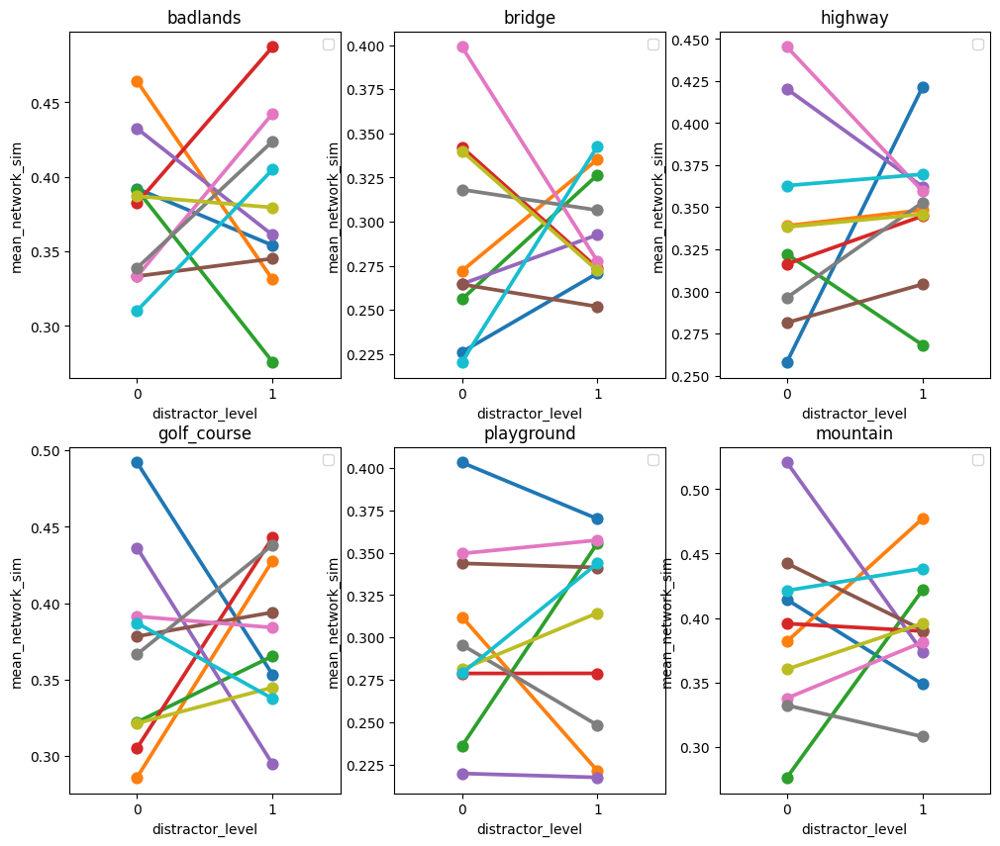

In [41]:
import seaborn as sns
fig,axes = plt.subplots(2,3,figsize = (12,10))
axes = axes.ravel()
numbers = []
for i in range(1,11):
    numbers.append(i)
    numbers.append(i)


for i,cat in enumerate(['badlands','bridge','highway','golf_course','playground','mountain']):
    cur_sim_df = all_cat_sim_df.loc[all_cat_sim_df['category1'] == cat]
    cur_sim_df['ID'] = numbers
    sns.pointplot(data=cur_sim_df,x='distractor_level', y='mean_network_sim', hue='ID',ax=axes[i])
    axes[i].set_title(cat)
    axes[i].legend('')

C:\Users\User\AppData\Local\Temp\ipykernel_936\3460068276.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df['ID'] = numbers
C:\Users\User\AppData\Local\Temp\ipykernel_936\3460068276.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df['ID'] = numbers
C:\Users\User\AppData\Local\Temp\ipykernel_936\3460068276.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

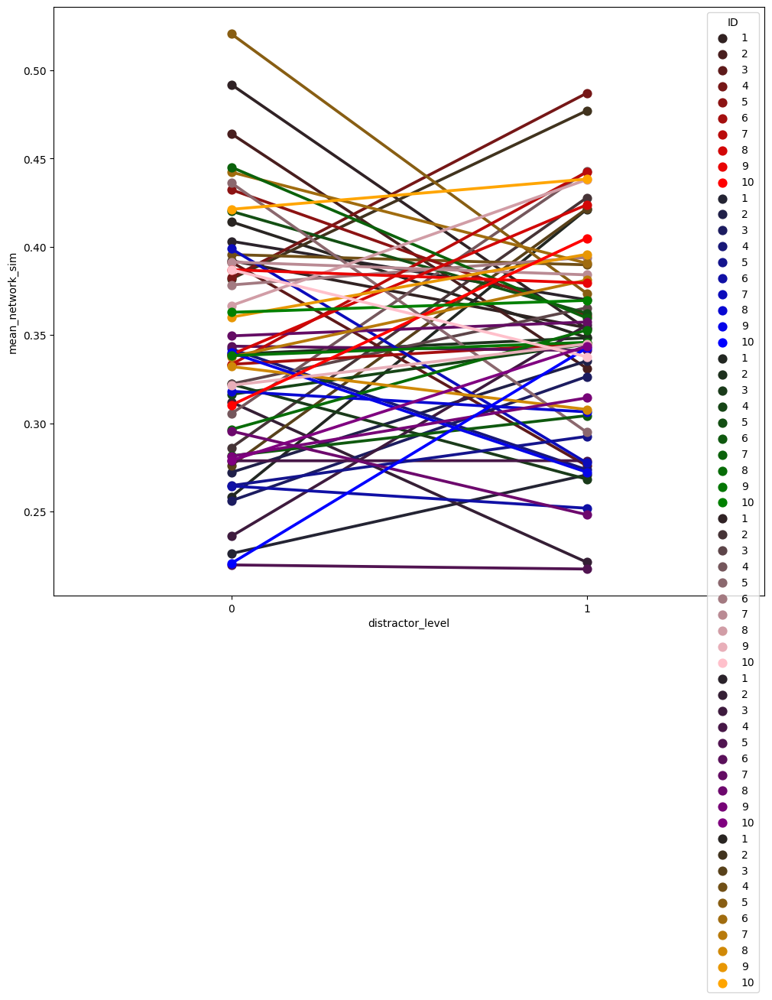

In [42]:
import seaborn as sns
fig,axes = plt.subplots(1,1,figsize = (12,10))
pallete = sns.color_palette('pastel',6)
colors = pallete.as_hex()

numbers = []
for i in range(1,11):
    numbers.append(i)
    numbers.append(i)

colors = ['red','blue','green','pink','purple','orange']
for i,cat in enumerate(['badlands','bridge','highway','golf_course','playground','mountain']):
    cur_df = all_cat_sim_df[all_cat_sim_df['category1'] == cat]
    cur_df['ID'] = numbers
    sns.pointplot(data=cur_df,x='distractor_level', y='mean_network_sim',hue = 'ID',color=colors[i])


### create target and distractors

In [43]:
all_images_names = all_cat_sim_df[['image1','image2']].values
all_images_names = all_images_names.flatten()# Get the unique values and their counts
unique, counts = np.unique(all_images_names, return_counts=True)

# Create a boolean mask for values that repeat twice
mask = counts == 2
# Apply the mask to the unique values
target_images  = unique[mask]
dict_target_dist = {}
for target in target_images:

    cur_df = all_cat_sim_df[(all_cat_sim_df['image1'] == target) | (all_cat_sim_df['image2'] == target)]


    list_for_target = list(np.zeros(2))
    for row in cur_df.T:
        cur_row = cur_df.loc[row]
        if cur_row['image1'] == target:
            dist = cur_row['image2']
        else: 
            dist = cur_row['image1']
        level = cur_row['distractor_level']
        list_for_target[level] = dist

    dict_target_dist[target] = list_for_target


# Convert the dictionary to a dataframe
target_and_distractor_images_df = pd.DataFrame.from_dict(dict_target_dist, orient='index')

# Reset the index and rename it as 'target'
target_and_distractor_images_df = target_and_distractor_images_df.reset_index().rename(columns={'index': 'target'})

# Rename the other columns as 'dist0' and 'dist1'
target_and_distractor_images_df = target_and_distractor_images_df.rename(columns={0: 'dist_0', 1: 'dist_1'})



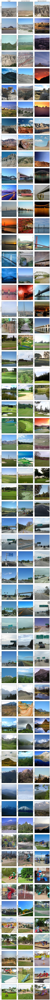

In [44]:
PATH_TO_ALL_EXP_IMG = PATH_TO_PROJECT/Path('experiment 1')/Path('experiment resources')/Path('images')/Path('all experiment images')
PATH_TO_ALL_TARGET_IMG = PATH_TO_PROJECT/Path('experiment 1')/Path('experiment resources')/Path('images')/Path('targets')
# Create a new figure with a subplot for each row in the dictionary
num_rows = len(target_and_distractor_images_df)
fig, axs = plt.subplots(num_rows, 3,figsize=(3*2*2,num_rows*2*2),sharex=True,sharey=True,gridspec_kw = {'wspace':0, 'hspace':0.1})

# Loop over the keys and values of the dictionary, and plot each image in the corresponding subplot
for i in range(num_rows):
   
    target_img_name = target_and_distractor_images_df.loc[i]['target']

    cat_name = target_img_name.split('_')[0]

    if 'golf' in target_img_name:
        cat_name = 'golf_course'
    # Load the image corresponding to the key
    img = mpimg.imread(PATH_TO_RAW_DATA/Path(cat_name)/Path(target_img_name))
    path_target = PATH_TO_ALL_TARGET_IMG / Path(target_img_name)
    path_all = PATH_TO_ALL_EXP_IMG / Path(target_img_name)
    # Save the image to another file
    plt.imsave(path_target, img)
    plt.imsave(path_all, img)
    
    # Plot the image in the left column of the current row
    axs[i, 0].imshow(img)
    axs[i, 0].set_ylabel(target_img_name)
    if i ==0:   
        axs[i, 0].set_title('Target')
    axs[i, 0].set_xticks([])
    axs[i, 0].set_yticks([])
    

    dist0_img_name = target_and_distractor_images_df.loc[i]['dist_0']
    img1 = mpimg.imread(PATH_TO_RAW_DATA/Path(cat_name)/Path(dist0_img_name))

    path_all = PATH_TO_ALL_EXP_IMG / Path(dist0_img_name)
    plt.imsave(path_all, img1)
    # Plot the image in the middle column of the current row
    axs[i, 1].imshow(img1)
    axs[i, 1].set_ylabel(dist0_img_name)
    if i ==0:   
        axs[i, 1].set_title('Low level distractor')
    axs[i, 1].set_xticks([])
    axs[i, 1].set_yticks([])
    

    dist1_img_name = target_and_distractor_images_df.loc[i]['dist_1']
    img2 = mpimg.imread(PATH_TO_RAW_DATA/Path(cat_name)/Path(dist1_img_name))
    path_all = PATH_TO_ALL_EXP_IMG / Path(dist1_img_name)
    plt.imsave(path_all, img2)
    # Plot the image in the right column of the current row
    axs[i, 2].imshow(img2)
    axs[i, 2].set_xticks([])
    axs[i, 2].set_yticks([])
    if i ==0:   
        axs[i, 2].set_title('High level distractor')
    axs[i, 2].set_ylabel(dist1_img_name)

fig_name = 'images_and_distractors'
#save the figure: 
svg_name=fig_name + '.svg'
png_name=fig_name + '.png'



fig.savefig(PATH_TO_PROJECT/Path('experiment 1/figures and outputs') / svg_name,format='svg',bbox_inches='tight')
fig.savefig(PATH_TO_PROJECT /Path('experiment 1/figures and outputs')/ png_name,format='png',bbox_inches='tight')

### T - Test 

In [45]:

d1 = all_cat_sim_df[all_cat_sim_df['distractor_level'] == 0 ]['mean_network_sim']
d2 = all_cat_sim_df[all_cat_sim_df['distractor_level'] == 1 ]['mean_network_sim']

t_stat, p_value = stats.ttest_rel(d1, d2)
print(t_stat, p_value)

-0.6198685469573282 0.537731073158933


<Axes: xlabel='variable', ylabel='value'>

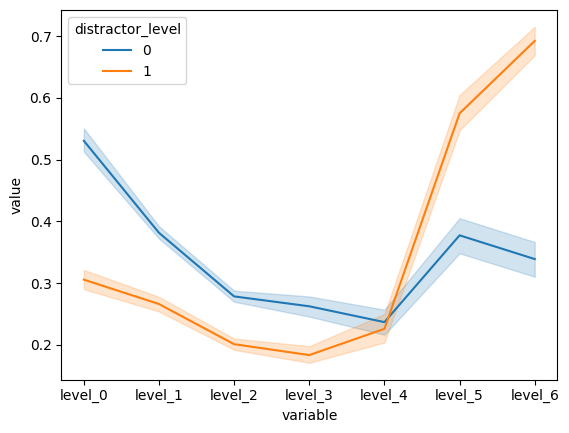

In [46]:
long_df = pd.melt(all_cat_sim_df, id_vars='distractor_level', value_vars=['level_0', 'level_1', 'level_2', 'level_3', 'level_4', 'level_5', 'level_6'])
sns.lineplot(data=long_df, x='variable',y='value',hue='distractor_level')

### Mean similarity

<Axes: >

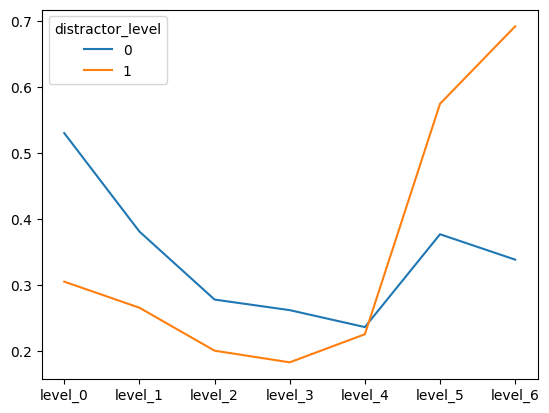

In [47]:
all_cat_sim_df.groupby('distractor_level')[['level_0','level_1','level_2','level_3','level_4','level_5','level_6']].mean().T.plot()

# create CSV 

In [48]:
target_and_distractor_images_df['category']=target_and_distractor_images_df['target'].apply(lambda x: x.split('_')[0])
inds=[]
# Create a vector of 10 numbers
vector = np.arange(10)

for sub in range(100): 
    # Select 5 numbers out of the vector
    all_dist1_indexes=[]
    all_dist2_indexes=[]
    sub_df=pd.DataFrame(columns=['target','distractor','distractor_type','category'],index=target_and_distractor_images_df.index)
    for i in range(6): 
        dist1 = set(np.random.choice(vector, size=5, replace=False))
        dist2 = set(vector)-set(dist1)

        dist1=np.array(list(dist1))+i*10
        dist2=np.array(list(dist2))+i*10
        #print(dist1,dist2)

        all_dist1_indexes.append(dist1)
        all_dist2_indexes.append(dist2)

    all_dist1_indexes=np.concatenate(all_dist1_indexes)    
    all_dist2_indexes=np.concatenate(all_dist2_indexes)    


    sub_df['target']=target_and_distractor_images_df['target']
    sub_df.loc[all_dist1_indexes,'distractor']=target_and_distractor_images_df.loc[all_dist1_indexes]['dist_0']
    sub_df.loc[all_dist2_indexes,'distractor']=target_and_distractor_images_df.loc[all_dist2_indexes]['dist_1']
    sub_df.loc[all_dist1_indexes,'distractor_type']=0
    sub_df.loc[all_dist2_indexes,'distractor_type']=1
    sub_df['category']=target_and_distractor_images_df['category']

    ## create subject encoding: 
    sub_encoding_df=sub_df[['target','category']].copy()
    sub_encoding_df.loc[:,'correct']=np.nan
    sub_encoding_df = sub_encoding_df.sample(frac=1).reset_index(drop=True)

    #add manipulation check in random positions (left right arrows) 
    top_index=[10,20,30,40,50]
    random_noise=[-4,-3,-2,-1,0,1,2,3,4]
    arrows=['right.jpg','left.jpg']
    for arrow in range(len(top_index)):
        chosen_noise=random.choice(random_noise)
        chosen_arrow=random.choice(arrows)
        chosen_idx=top_index[arrow]+chosen_noise - 0.5
        correct=chosen_arrow.split('.')[0]

        new_row = [chosen_arrow,None,correct]

        sub_encoding_df.loc[chosen_idx]=new_row
        sub_encoding_df=sub_encoding_df.sort_index().reset_index(drop=True)
    sub_encoding_df.head(20)

    ## create sub test
    curr_sub_df=sub_df
    curr_sub_df = curr_sub_df.sample(frac=1).reset_index(drop=True)
    curr_sub_df['correct']=None

    #create the test.csv for this participants: 
    correct_column = []
    sub_test_df=curr_sub_df.copy()
    for row in sub_test_df.T:
        random_pick = np.random.randint(0,2)

        if random_pick == 0:
            correct_column.append('left')
        elif random_pick == 1:
            sub_test_df.loc[row,['target','distractor']] = sub_test_df.loc[row,['distractor','target']].values

            correct_column.append('right')

    sub_test_df['correct'] = correct_column
    sub_test_df.columns = ['image1', 'image2', 'layer','category', 'correct']
    sub_test_df = sub_test_df.sample(frac=1).reset_index(drop=True)

    #save subject encoding and test: 
    sub_test_df.to_csv(PATH_TO_EXPERIMENT_CSV_FILES / Path(f'sub_test{sub}.csv'), index=False)
    sub_encoding_df.to_csv(PATH_TO_EXPERIMENT_CSV_FILES / Path(f'sub_encoding{sub}.csv'),index=False)    

In [15]:
target_and_distractor_images_df

,target,dist_0,dist_1,category
0,badlands_113.jpg,badlands_225.jpg,badlands_203.jpg,badlands
1,badlands_137.jpg,badlands_194.jpg,badlands_139.jpg,badlands
2,badlands_184.jpg,badlands_228.jpg,badlands_103.jpg,badlands
3,badlands_21.jpg,badlands_1.jpg,badlands_98.jpg,badlands
4,badlands_221.jpg,badlands_115.jpg,badlands_207.jpg,badlands
5,badlands_222.jpg,badlands_34.jpg,badlands_62.jpg,badlands
6,badlands_23.jpg,badlands_114.jpg,badlands_101.jpg,badlands
7,badlands_24.jpg,badlands_3.jpg,badlands_53.jpg,badlands
8,badlands_52.jpg,badlands_94.jpg,badlands_63.jpg,badlands
9,badlands_70.jpg,badlands_102.jpg,badlands_119.jpg,badlands


In [20]:
all_test_df = pd.DataFrame([])
for csv in PATH_TO_EXPERIMENT_CSV_FILES.iterdir():
    if 'test' in csv.name:
        cur_test_df = pd.read_csv(csv)
        all_test_df = pd.concat([all_test_df,cur_test_df])

In [27]:
all_test_df['joined'] = all_test_df['image1'] + all_test_df['image2']
im1 = all_test_df['image1'].value_counts()

im2 = all_test_df['image2'].value_counts()

mountain_154.jpg       62
mountain_293.jpg       61
highway_93.jpg         60
golf_course_116.jpg    60
bridge_108.jpg         60
                       ..
mountain_3.jpg         17
bridge_54.jpg          16
mountain_94.jpg        16
mountain_47.jpg        15
bridge_116.jpg         14
Name: image1, Length: 180, dtype: int64

<Axes: ylabel='Frequency'>

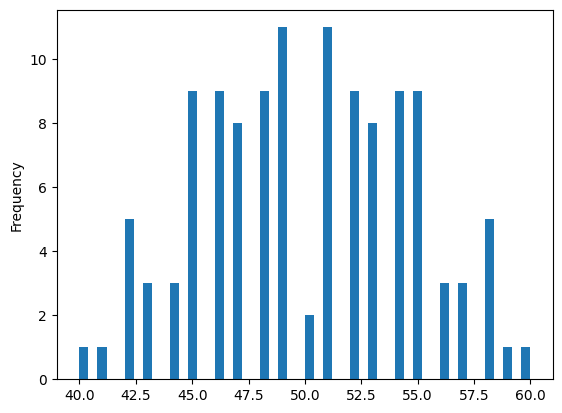

In [35]:
# combine the two columns into a single column of tuples, ignoring order
pairs = all_test_df[['image1','image2']].apply(lambda row: tuple(sorted(row)), axis=1)

# count the occurrences of each unique value pair
pair_counts = pairs.value_counts()

pair_counts.plot(kind='hist',bins = 50)